In [20]:
import pandas as pd
import numpy as np
import pandas_ta as ta
import vectorbt as vbt
import yfinance as yf
import seaborn as sns
import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (15,8)

# 1h btc can download 2y 

In [21]:
df = yf.download(tickers='BNB-USD',period='23mo',interval='1h')
df.head()

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
2021-02-10 17:00:00,127.344437,132.761948,124.996498,132.761948,132.761948,0
2021-02-10 18:00:00,132.598709,132.651825,127.045868,128.477325,128.477325,0
2021-02-10 19:00:00,128.617462,128.714111,125.780960,128.072998,128.072998,0
2021-02-10 20:00:00,128.125473,128.125473,121.120926,122.875092,122.875092,0
2021-02-10 21:00:00,122.192406,128.269394,122.192406,126.075050,126.075050,141382656


In [22]:
df.ta.macd(append=True)

,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9
2021-02-10 17:00:00,NaN,NaN,NaN
2021-02-10 18:00:00,NaN,NaN,NaN
2021-02-10 19:00:00,NaN,NaN,NaN
2021-02-10 20:00:00,NaN,NaN,NaN
2021-02-10 21:00:00,NaN,NaN,NaN
...,...,...,...
2023-01-10 14:00:00,0.044306,-0.085687,0.129993
2023-01-10 15:00:00,0.113699,-0.013035,0.126734
2023-01-10 16:00:00,0.099860,-0.021499,0.121359
2023-01-10 17:00:00,0.088783,-0.026061,0.114844


In [23]:
df['s+,h+'] = (df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']>0)
df['s+,h-'] = (df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']<0)
df['s-,h-'] = (df['MACD_12_26_9']<0)& (df['MACDh_12_26_9']<0)
df['s-,h+'] = (df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']>0)
df
# for vbt can plot

,Open,High,Low,Close,Adj Close,Volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,"s+,h+","s+,h-","s-,h-","s-,h+"
2021-02-10 17:00:00,127.344437,132.761948,124.996498,132.761948,132.761948,0,NaN,NaN,NaN,False,False,False,False
2021-02-10 18:00:00,132.598709,132.651825,127.045868,128.477325,128.477325,0,NaN,NaN,NaN,False,False,False,False
2021-02-10 19:00:00,128.617462,128.714111,125.780960,128.072998,128.072998,0,NaN,NaN,NaN,False,False,False,False
2021-02-10 20:00:00,128.125473,128.125473,121.120926,122.875092,122.875092,0,NaN,NaN,NaN,False,False,False,False
2021-02-10 21:00:00,122.192406,128.269394,122.192406,126.075050,126.075050,141382656,NaN,NaN,NaN,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-01-10 14:00:00,274.574951,276.011322,274.438263,275.352356,275.352356,0,0.044306,-0.085687,0.129993,False,True,False,False
2023-01-10 15:00:00,275.286560,276.299744,275.044098,275.896973,275.896973,6415552,0.113699,-0.013035,0.126734,False,True,False,False
2023-01-10 16:00:00,275.857208,275.860229,274.729797,275.058197,275.058197,1435968,0.099860,-0.021499,0.121359,False,True,False,False
2023-01-10 17:00:00,275.024689,275.196442,274.826874,275.069519,275.069519,204736,0.088783,-0.026061,0.114844,False,True,False,False


In [24]:
df.loc[(df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']>0), 'condition']='s+,h+'
df.loc[(df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']<0), 'condition']='s+,h-'
df.loc[(df['MACD_12_26_9']<0)& (df['MACDh_12_26_9']<0), 'condition']='s-,h-'
df.loc[(df['MACD_12_26_9']<0)& (df['MACDh_12_26_9']>0), 'condition']='s-,h+'


In [25]:
df.iloc[:,-8:]

,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,"s+,h+","s+,h-","s-,h-","s-,h+",condition
2021-02-10 17:00:00,NaN,NaN,NaN,False,False,False,False,NaN
2021-02-10 18:00:00,NaN,NaN,NaN,False,False,False,False,NaN
2021-02-10 19:00:00,NaN,NaN,NaN,False,False,False,False,NaN
2021-02-10 20:00:00,NaN,NaN,NaN,False,False,False,False,NaN
2021-02-10 21:00:00,NaN,NaN,NaN,False,False,False,False,NaN
...,...,...,...,...,...,...,...,...
2023-01-10 14:00:00,0.044306,-0.085687,0.129993,False,True,False,False,"s+,h-"
2023-01-10 15:00:00,0.113699,-0.013035,0.126734,False,True,False,False,"s+,h-"
2023-01-10 16:00:00,0.099860,-0.021499,0.121359,False,True,False,False,"s+,h-"
2023-01-10 17:00:00,0.088783,-0.026061,0.114844,False,True,False,False,"s+,h-"


In [26]:
filter =df[['s+,h+','s+,h-','s-,h-','s-,h+']]

In [27]:
filter

,"s+,h+","s+,h-","s-,h-","s-,h+"
2021-02-10 17:00:00,False,False,False,False
2021-02-10 18:00:00,False,False,False,False
2021-02-10 19:00:00,False,False,False,False
2021-02-10 20:00:00,False,False,False,False
2021-02-10 21:00:00,False,False,False,False
...,...,...,...,...
2023-01-10 14:00:00,False,True,False,False
2023-01-10 15:00:00,False,True,False,False
2023-01-10 16:00:00,False,True,False,False
2023-01-10 17:00:00,False,True,False,False


In [28]:
# let say we have a condition
# just entries price > ema12 , exit price <26
# but weight is varies
# define weight by macd quadrant
df['ema12'] = df.ta.ema(12)
df['ema26']=df.ta.ema(26)

In [29]:
df.loc[(df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']>0), 'aweight']=1
df.loc[(df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']<0), 'aweight']=0.2
df.loc[(df['MACD_12_26_9']<0)& (df['MACDh_12_26_9']<0), 'aweight']=1
df.loc[(df['MACD_12_26_9']<0)& (df['MACDh_12_26_9']>0), 'aweight']=1

In [30]:
long_entries = df['Close'].vbt.crossed_above(df['ema12'])
long_exits = df['Close'].vbt.crossed_below(df['ema26'])

In [31]:
port=vbt.Portfolio.from_signals(df.Close,
                               entries = long_entries,
                               exits= long_exits,
                               init_cash=10000,
                               size=df['aweight'],
                               size_type='Percent',
                               direction=0)

In [32]:
port.plot().show()

In [14]:
port.stats()

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2021-02-10 17:00:00
End                           2023-01-10 17:36:00
Period                                      16554
Start Value                               10000.0
End Value                             26275.18587
Total Return [%]                       162.751859
Benchmark Return [%]                   -61.536874
Max Gross Exposure [%]                      100.0
Total Fees Paid                               0.0
Max Drawdown [%]                        35.338026
Max Drawdown Duration                      7565.0
Total Trades                                  795
Total Closed Trades                           794
Total Open Trades                               1
Open Trade PnL                          14.258983
Win Rate [%]                            34.130982
Best Trade [%]                           12.78575
Worst Trade [%]                        -12.253211
Avg Winning Trade [%]                    1.998012
Avg Losing Trade [%]                      -0.8242


In [15]:
trade_log = port.trades.records_readable
trade_log

,Exit Trade Id,Column,Size,Entry Timestamp,Avg Entry Price,Entry Fees,Exit Timestamp,Avg Exit Price,Exit Fees,PnL,Return,Direction,Status,Position Id
0,0,0,0.042016,2021-02-12 11:00:00,47601.050781,0.0,2021-02-12 14:00:00,46574.183594,0.0,-43.144728,-0.021572,Long,Closed,0
1,1,0,0.041826,2021-02-12 16:00:00,47610.679688,0.0,2021-02-13 07:00:00,47284.777344,0.0,-13.631238,-0.006845,Long,Closed,1
2,2,0,0.210834,2021-02-13 21:00:00,47161.464844,0.0,2021-02-15 01:00:00,48132.703125,0.0,204.769717,0.020594,Long,Closed,2
3,3,0,0.212869,2021-02-15 08:00:00,47672.519531,0.0,2021-02-15 14:00:00,47713.449219,0.0,8.712655,0.000859,Long,Closed,3
4,4,0,0.211752,2021-02-15 15:00:00,47965.093750,0.0,2021-02-15 23:00:00,47943.925781,0.0,-4.482361,-0.000441,Long,Closed,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
790,790,0,1.532424,2023-01-06 15:00:00,16826.978516,0.0,2023-01-08 12:00:00,16933.037109,0.0,162.526685,0.006303,Long,Closed,790
791,791,0,0.306014,2023-01-08 14:00:00,16959.058594,0.0,2023-01-08 17:00:00,16932.734375,0.0,-8.055591,-0.001552,Long,Closed,791
792,792,0,1.528057,2023-01-08 20:00:00,16976.152344,0.0,2023-01-09 21:00:00,17190.298828,0.0,327.228042,0.012615,Long,Closed,792
793,793,0,0.304912,2023-01-10 04:00:00,17229.718750,0.0,2023-01-10 07:00:00,17207.318359,0.0,-6.830152,-0.001300,Long,Closed,793


This section is Filter about series
it like 
df[df==True]

In [16]:
df['aweight'][trade_log['Entry Timestamp']]

2021-02-12 11:00:00    0.2
2021-02-12 16:00:00    0.2
2021-02-13 21:00:00    1.0
2021-02-15 08:00:00    1.0
2021-02-15 15:00:00    1.0
                      ... 
2023-01-06 15:00:00    1.0
2023-01-08 14:00:00    0.2
2023-01-08 20:00:00    1.0
2023-01-10 04:00:00    0.2
2023-01-10 08:00:00    0.2
Name: aweight, Length: 795, dtype: float64

In [17]:
df['aweight'][trade_log['Entry Timestamp']].value_counts()

1.0    572
0.2    223
Name: aweight, dtype: int64

In [18]:
df['condition'][trade_log['Entry Timestamp']].value_counts()

s-,h-    246
s-,h+    241
s+,h-    223
s+,h+     85
Name: condition, dtype: int64

In [19]:
result=trade_log.join(df['aweight'],how='left',on='Entry Timestamp')
result
# this section is about python join left between df awight and tradelog and create  result



,Exit Trade Id,Column,Size,Entry Timestamp,Avg Entry Price,Entry Fees,Exit Timestamp,Avg Exit Price,Exit Fees,PnL,Return,Direction,Status,Position Id,aweight
0,0,0,0.042016,2021-02-12 11:00:00,47601.050781,0.0,2021-02-12 14:00:00,46574.183594,0.0,-43.144728,-0.021572,Long,Closed,0,0.2
1,1,0,0.041826,2021-02-12 16:00:00,47610.679688,0.0,2021-02-13 07:00:00,47284.777344,0.0,-13.631238,-0.006845,Long,Closed,1,0.2
2,2,0,0.210834,2021-02-13 21:00:00,47161.464844,0.0,2021-02-15 01:00:00,48132.703125,0.0,204.769717,0.020594,Long,Closed,2,1.0
3,3,0,0.212869,2021-02-15 08:00:00,47672.519531,0.0,2021-02-15 14:00:00,47713.449219,0.0,8.712655,0.000859,Long,Closed,3,1.0
4,4,0,0.211752,2021-02-15 15:00:00,47965.093750,0.0,2021-02-15 23:00:00,47943.925781,0.0,-4.482361,-0.000441,Long,Closed,4,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
790,790,0,1.532424,2023-01-06 15:00:00,16826.978516,0.0,2023-01-08 12:00:00,16933.037109,0.0,162.526685,0.006303,Long,Closed,790,1.0
791,791,0,0.306014,2023-01-08 14:00:00,16959.058594,0.0,2023-01-08 17:00:00,16932.734375,0.0,-8.055591,-0.001552,Long,Closed,791,0.2
792,792,0,1.528057,2023-01-08 20:00:00,16976.152344,0.0,2023-01-09 21:00:00,17190.298828,0.0,327.228042,0.012615,Long,Closed,792,1.0
793,793,0,0.304912,2023-01-10 04:00:00,17229.718750,0.0,2023-01-10 07:00:00,17207.318359,0.0,-6.830152,-0.001300,Long,Closed,793,0.2


In [113]:
type(result)

pandas.core.frame.DataFrame

In [114]:
result[result.aweight == 1]

# filter result

,Exit Trade Id,Column,Size,Entry Timestamp,Avg Entry Price,Entry Fees,Exit Timestamp,Avg Exit Price,Exit Fees,PnL,Return,Direction,Status,Position Id,aweight
0,0,0,0.259331,2021-02-08 04:00:00,38560.707031,0.0,2021-02-10 04:00:00,45952.808594,0.0,1917.003637,0.191700,Long,Closed,0,1.0
2,2,0,0.262419,2021-02-11 03:00:00,45265.507812,0.0,2021-02-12 14:00:00,46574.183594,0.0,343.421951,0.028911,Long,Closed,2,1.0
5,5,0,0.258378,2021-02-13 21:00:00,47161.464844,0.0,2021-02-15 01:00:00,48132.703125,0.0,250.946231,0.020594,Long,Closed,5,1.0
6,6,0,0.260872,2021-02-15 08:00:00,47672.519531,0.0,2021-02-15 14:00:00,47713.449219,0.0,10.677399,0.000859,Long,Closed,6,1.0
7,7,0,0.259503,2021-02-15 15:00:00,47965.093750,0.0,2021-02-15 23:00:00,47943.925781,0.0,-5.493153,-0.000441,Long,Closed,7,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
784,784,0,1.890487,2023-01-01 10:00:00,16546.949219,0.0,2023-01-01 13:00:00,16552.162109,0.0,9.854903,0.000315,Long,Closed,784,1.0
785,785,0,1.884778,2023-01-02 02:00:00,16602.296875,0.0,2023-01-02 23:00:00,16688.482422,0.0,162.440661,0.005191,Long,Closed,785,1.0
787,787,0,1.885216,2023-01-03 23:00:00,16679.951172,0.0,2023-01-04 20:00:00,16804.451172,0.0,234.709416,0.007464,Long,Closed,787,1.0
792,792,0,1.876920,2023-01-06 00:00:00,16860.906250,0.0,2023-01-06 01:00:00,16836.587891,0.0,-45.643621,-0.001442,Long,Closed,792,1.0


<AxesSubplot:>

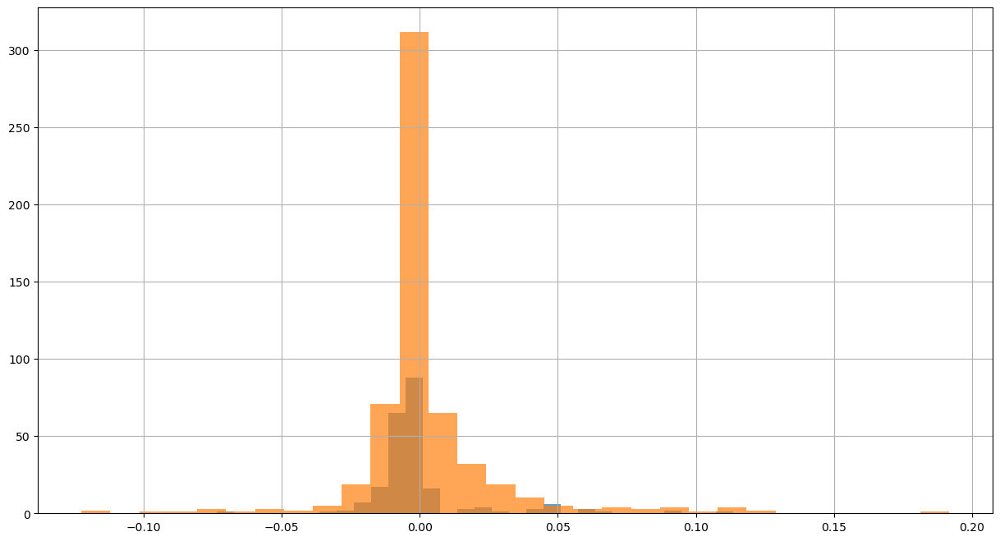

In [118]:
result[result.aweight== 0.2]['Return'].hist(bins=30,alpha=0.7)
result[result.aweight== 1]['Return'].hist(bins=30,alpha=0.7)

In [ ]:
# this section is experiment about weight in diffrent type of macd

In [119]:
df2 = df.copy()

In [121]:
df2.loc[(df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']>0), 'aweight']=0.9
df2.loc[(df['MACD_12_26_9']>0)& (df['MACDh_12_26_9']<0), 'aweight']=0.2
df2.loc[(df['MACD_12_26_9']<0)& (df['MACDh_12_26_9']<0), 'aweight']=0.3
df2.loc[(df['MACD_12_26_9']<0)& (df['MACDh_12_26_9']>0), 'aweight']=0.7

In [124]:
port2=vbt.Portfolio.from_signals(df2.Close,
                               entries = long_entries,
                               exits= long_exits,
                               init_cash=10000,
                               size=df['aweight'],
                               size_type='Percent',
                               direction=0)

In [125]:
port2.plot().show()

In [128]:
port2.stats()

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2021-02-06 16:00:00
End                           2023-01-06 16:34:00
Period                                      16554
Start Value                               10000.0
End Value                            31567.400246
Total Return [%]                       215.674002
Benchmark Return [%]                   -58.529563
Max Gross Exposure [%]                      100.0
Total Fees Paid                               0.0
Max Drawdown [%]                        35.338026
Max Drawdown Duration                      7468.0
Total Trades                                  794
Total Closed Trades                           793
Total Open Trades                               1
Open Trade PnL                         -33.532429
Win Rate [%]                            34.174023
Best Trade [%]                          19.170036
Worst Trade [%]                        -12.253211
Avg Winning Trade [%]                    2.072438
Avg Losing Trade [%]                    -0.825742


In [129]:
trade_log2 = port.trades.records_readable
trade_log2

,Exit Trade Id,Column,Size,Entry Timestamp,Avg Entry Price,Entry Fees,Exit Timestamp,Avg Exit Price,Exit Fees,PnL,Return,Direction,Status,Position Id
0,0,0,0.259331,2021-02-08 04:00:00,38560.707031,0.0,2021-02-10 04:00:00,45952.808594,0.0,1917.003637,0.191700,Long,Closed,0
1,1,0,0.051306,2021-02-10 06:00:00,46454.511719,0.0,2021-02-10 12:00:00,45704.992188,0.0,-38.454939,-0.016134,Long,Closed,1
2,2,0,0.262419,2021-02-11 03:00:00,45265.507812,0.0,2021-02-12 14:00:00,46574.183594,0.0,343.421951,0.028911,Long,Closed,2
3,3,0,0.051341,2021-02-12 16:00:00,47610.679688,0.0,2021-02-12 18:00:00,47222.894531,0.0,-19.909394,-0.008145,Long,Closed,3
4,4,0,0.051260,2021-02-12 20:00:00,47608.507812,0.0,2021-02-13 07:00:00,47284.777344,0.0,-16.594425,-0.006800,Long,Closed,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
789,789,0,0.376153,2023-01-05 10:00:00,16836.763672,0.0,2023-01-05 13:00:00,16801.863281,0.0,-13.127898,-0.002073,Long,Closed,789
790,790,0,0.376021,2023-01-05 14:00:00,16835.707031,0.0,2023-01-05 17:00:00,16825.722656,0.0,-3.754334,-0.000593,Long,Closed,790
791,791,0,0.375827,2023-01-05 18:00:00,16842.410156,0.0,2023-01-05 23:00:00,16835.585938,0.0,-2.564724,-0.000405,Long,Closed,791
792,792,0,1.876920,2023-01-06 00:00:00,16860.906250,0.0,2023-01-06 01:00:00,16836.587891,0.0,-45.643621,-0.001442,Long,Closed,792


In [130]:
df2['aweight'][trade_log2['Entry Timestamp']].value_counts()

0.3    247
0.7    242
0.2    221
0.9     84
Name: aweight, dtype: int64

In [139]:
df['condition'][trade_log['Entry Timestamp']].value_counts()

s-,h-    247
s-,h+    242
s+,h-    221
s+,h+     84
Name: condition, dtype: int64

In [131]:
result2=trade_log2.join(df2['aweight'],how='left',on='Entry Timestamp')
result2
# this section is about python join left between df awight and tradelog and create  result


,Exit Trade Id,Column,Size,Entry Timestamp,Avg Entry Price,Entry Fees,Exit Timestamp,Avg Exit Price,Exit Fees,PnL,Return,Direction,Status,Position Id,aweight
0,0,0,0.259331,2021-02-08 04:00:00,38560.707031,0.0,2021-02-10 04:00:00,45952.808594,0.0,1917.003637,0.191700,Long,Closed,0,0.7
1,1,0,0.051306,2021-02-10 06:00:00,46454.511719,0.0,2021-02-10 12:00:00,45704.992188,0.0,-38.454939,-0.016134,Long,Closed,1,0.2
2,2,0,0.262419,2021-02-11 03:00:00,45265.507812,0.0,2021-02-12 14:00:00,46574.183594,0.0,343.421951,0.028911,Long,Closed,2,0.3
3,3,0,0.051341,2021-02-12 16:00:00,47610.679688,0.0,2021-02-12 18:00:00,47222.894531,0.0,-19.909394,-0.008145,Long,Closed,3,0.2
4,4,0,0.051260,2021-02-12 20:00:00,47608.507812,0.0,2021-02-13 07:00:00,47284.777344,0.0,-16.594425,-0.006800,Long,Closed,4,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
789,789,0,0.376153,2023-01-05 10:00:00,16836.763672,0.0,2023-01-05 13:00:00,16801.863281,0.0,-13.127898,-0.002073,Long,Closed,789,0.2
790,790,0,0.376021,2023-01-05 14:00:00,16835.707031,0.0,2023-01-05 17:00:00,16825.722656,0.0,-3.754334,-0.000593,Long,Closed,790,0.2
791,791,0,0.375827,2023-01-05 18:00:00,16842.410156,0.0,2023-01-05 23:00:00,16835.585938,0.0,-2.564724,-0.000405,Long,Closed,791,0.2
792,792,0,1.876920,2023-01-06 00:00:00,16860.906250,0.0,2023-01-06 01:00:00,16836.587891,0.0,-45.643621,-0.001442,Long,Closed,792,0.9


<AxesSubplot:>

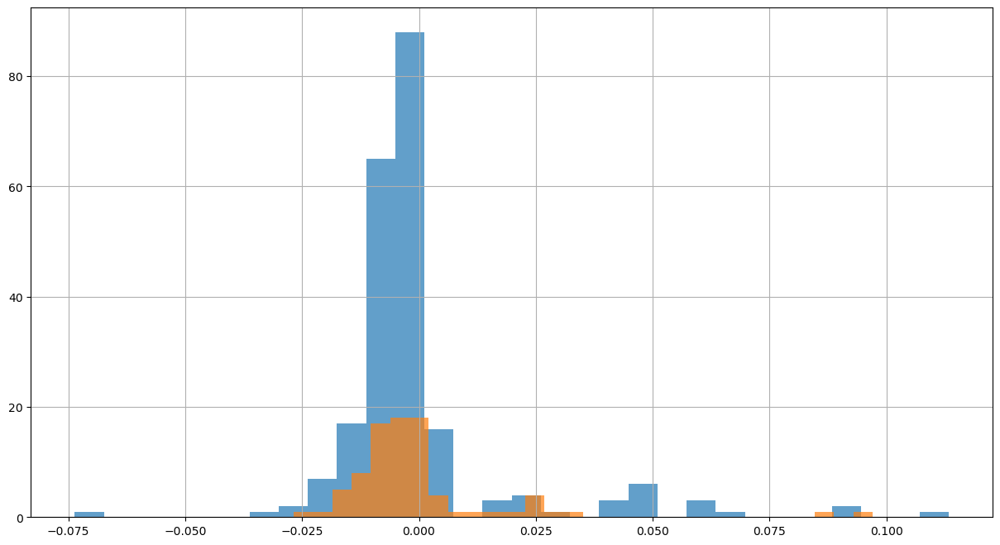

In [138]:
result2[result2.aweight== 0.2]['Return'].hist(bins=30,alpha=0.7)
result2[result2.aweight== 0.9]['Return'].hist(bins=30,alpha=0.7)

<AxesSubplot:>

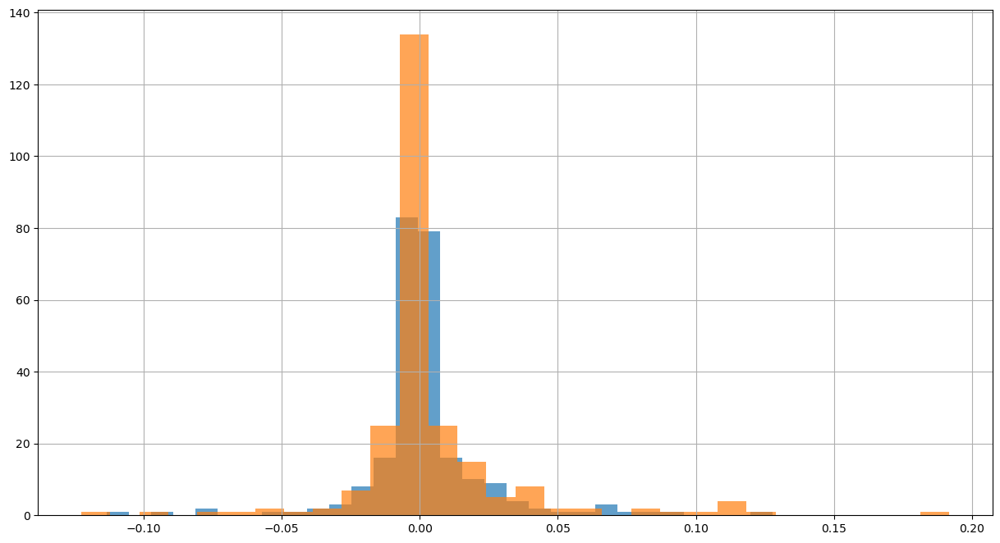

In [137]:
result2[result2.aweight== 0.3]['Return'].hist(bins=30,alpha=0.7)
result2[result2.aweight== 0.7]['Return'].hist(bins=30,alpha=0.7)

<AxesSubplot:>

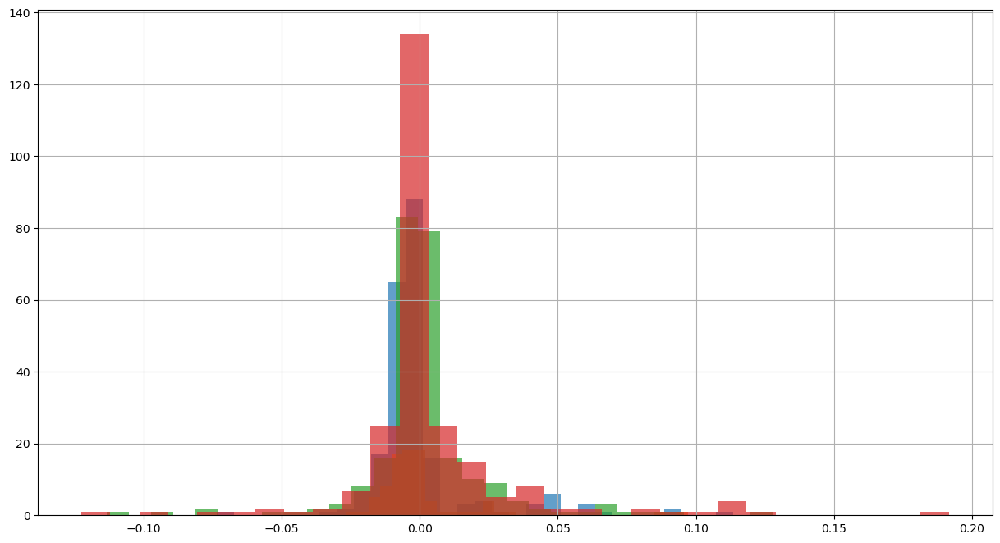

In [136]:
result2[result2.aweight== 0.2]['Return'].hist(bins=30,alpha=0.7)
result2[result2.aweight== 0.9]['Return'].hist(bins=30,alpha=0.7)
result2[result2.aweight== 0.3]['Return'].hist(bins=30,alpha=0.7)
result2[result2.aweight== 0.7]['Return'].hist(bins=30,alpha=0.7)